In [65]:
import os

os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

import sys
import torch
import numpy as np
import matplotlib.pyplot as plt
import random
import logging
from tqdm import tqdm
from torch.utils.data import DataLoader
from datasets.synapse_dataset import SynapseDataset
from utils import test_single_volume, calculate_metric_percase
import SimpleITK as sitk
from scipy.ndimage import zoom
from medpy import metric

In [66]:
seed = 1234
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed(seed)

In [67]:
print("GPU có sẵn:", torch.cuda.is_available())


GPU có sẵn: True


In [68]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Sử dụng thiết bị:", device)

Sử dụng thiết bị: cuda


In [69]:
from networks.vit_seg_modeling import VisionTransformer as ViT_seg
from networks.vit_seg_modeling import CONFIGS as CONFIGS_ViT_seg

In [70]:
def load_trained_model(snapshot_path, vit_name, img_size, num_classes, n_skip, vit_patches_size, is_pretrain=True):
    config_vit = CONFIGS_ViT_seg[vit_name]
    config_vit.n_classes = num_classes
    config_vit.n_skip = n_skip
    config_vit.patches.size = (vit_patches_size, vit_patches_size)
    if vit_name.find('R50') != -1:
        config_vit.patches.grid = (int(img_size / vit_patches_size), int(img_size / vit_patches_size))

    model = ViT_seg(config_vit, img_size=img_size, num_classes=num_classes)
    model = model.to(device)

    # Đường dẫn checkpoint ví dụ: epoch_(max_epochs-1).pth
    checkpoint = os.path.join(snapshot_path, 'epoch_149.pth')  # Cập nhật theo checkpoint của bạn
    if not os.path.exists(checkpoint):
        raise FileNotFoundError(f"Checkpoint file không tồn tại: {checkpoint}")
    state_dict = torch.load(checkpoint, map_location=device, weights_only=True)
    model.load_state_dict(state_dict)
    print("Load model thành công từ:", checkpoint)
    return model

In [71]:
snapshot_path = "../model/TU_synapse224/TU_pretrain_R50-ViT-B_16_skip3_epo150_bs2_224"
vit_name = "R50-ViT-B_16"
img_size = 224
num_classes = 9
n_skip = 3
vit_patches_size = 16

In [72]:
model = load_trained_model(snapshot_path, vit_name, img_size, num_classes, n_skip, vit_patches_size)

Load model thành công từ: ../model/TU_synapse224/TU_pretrain_R50-ViT-B_16_skip3_epo150_bs2_224\epoch_149.pth


---

In [87]:
volume_path = "../data/synapse/processed/test"  # Đường dẫn đến dữ liệu test
list_dir = "../data/synapse/list"  # Thư mục chứa danh sách case
num_classes = 9  # Số lớp segmentation
img_size = 224  # Kích thước ảnh đầu vào
z_spacing = 1.0  # Z spacing để lưu ảnh
test_save_path = None  # Có thể đặt đường dẫn nếu muốn lưu kết quả

In [94]:
test_dataset = SynapseDataset(base_dir=volume_path, split="test", list_dir=list_dir)
test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False, num_workers=1)

In [89]:
print("Số ca test:", len(test_dataset))

Số ca test: 72


In [90]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)
model.eval()

VisionTransformer(
  (transformer): Transformer(
    (embeddings): Embeddings(
      (hybrid_model): ResNetV2(
        (root): Sequential(
          (conv): StdConv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
          (gn): GroupNorm(32, 64, eps=1e-06, affine=True)
          (relu): ReLU(inplace=True)
        )
        (body): Sequential(
          (block1): Sequential(
            (unit1): PreActBottleneck(
              (gn1): GroupNorm(32, 64, eps=1e-06, affine=True)
              (conv1): StdConv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (gn2): GroupNorm(32, 64, eps=1e-06, affine=True)
              (conv2): StdConv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
              (gn3): GroupNorm(32, 256, eps=1e-06, affine=True)
              (conv3): StdConv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
              (relu): ReLU(inplace=True)
              (downsample): StdConv2d(64, 256, 

In [92]:
metric_list = 0.0
for i_batch, sampled_batch in tqdm(enumerate(test_loader), total=len(test_loader)):
    image = sampled_batch["image"].to(device)  # Chuyển ảnh lên GPU nếu có
    label = sampled_batch["label"].to(device)
    case_name = sampled_batch["case_name"][0]  # Lấy tên case

    # Gọi hàm test_single_volume để tính metric
    metric_i = test_single_volume(
        image, label, model, classes=num_classes,
        patch_size=[img_size, img_size], test_save_path=test_save_path,
        case=case_name, z_spacing=z_spacing
    )

    # Cộng dồn metric
    metric_list += np.array(metric_i)
    print(f"Case {case_name}: Mean Dice = {np.mean(metric_i, axis=0)[0]:.4f}, Mean HD95 = {np.mean(metric_i, axis=0)[1]:.4f}")

  1%|▏         | 1/72 [00:13<16:32, 13.99s/it]

Case det0000301: Mean Dice = 0.1250, Mean HD95 = 0.0000


  3%|▎         | 2/72 [00:22<12:44, 10.92s/it]

Case det0000601: Mean Dice = 0.1250, Mean HD95 = 0.0000


  4%|▍         | 3/72 [00:32<11:53, 10.35s/it]

Case det0000701: Mean Dice = 0.1250, Mean HD95 = 0.0000


  6%|▌         | 4/72 [00:41<11:07,  9.82s/it]

Case det0007301: Mean Dice = 0.1250, Mean HD95 = 0.0000


  7%|▋         | 5/72 [00:50<10:32,  9.44s/it]

Case det0007401: Mean Dice = 0.1250, Mean HD95 = 0.0000


  8%|▊         | 6/72 [00:58<10:08,  9.22s/it]

Case det0007501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 10%|▉         | 7/72 [01:07<09:41,  8.95s/it]

Case det0007601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 11%|█         | 8/72 [01:15<09:20,  8.76s/it]

Case det0007801: Mean Dice = 0.1250, Mean HD95 = 0.0000


 12%|█▎        | 9/72 [01:24<09:06,  8.67s/it]

Case det0008301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 14%|█▍        | 10/72 [01:32<08:57,  8.67s/it]

Case det0008501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 15%|█▌        | 11/72 [01:41<08:47,  8.64s/it]

Case det0008601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 17%|█▋        | 12/72 [01:50<08:38,  8.64s/it]

Case det0008701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 18%|█▊        | 13/72 [01:58<08:27,  8.60s/it]

Case det0009101: Mean Dice = 0.1250, Mean HD95 = 0.0000


 19%|█▉        | 14/72 [02:07<08:18,  8.60s/it]

Case det0009401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 21%|██        | 15/72 [02:15<08:09,  8.59s/it]

Case det0009501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 22%|██▏       | 16/72 [02:24<08:00,  8.58s/it]

Case det0009701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 24%|██▎       | 17/72 [02:33<07:54,  8.62s/it]

Case det0010001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 25%|██▌       | 18/72 [02:41<07:45,  8.62s/it]

Case det0010201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 26%|██▋       | 19/72 [02:50<07:37,  8.63s/it]

Case det0010401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 28%|██▊       | 20/72 [02:59<07:29,  8.64s/it]

Case det0010501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 29%|██▉       | 21/72 [03:07<07:21,  8.66s/it]

Case det0010701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 31%|███       | 22/72 [03:16<07:12,  8.65s/it]

Case det0010801: Mean Dice = 0.1250, Mean HD95 = 0.0000


 32%|███▏      | 23/72 [03:24<07:02,  8.63s/it]

Case det0010901: Mean Dice = 0.1250, Mean HD95 = 0.0000


 33%|███▎      | 24/72 [03:33<06:56,  8.69s/it]

Case det0011201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 35%|███▍      | 25/72 [03:42<06:46,  8.65s/it]

Case det0011301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 36%|███▌      | 26/72 [03:50<06:37,  8.64s/it]

Case det0011401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 38%|███▊      | 27/72 [03:59<06:29,  8.66s/it]

Case det0011501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 39%|███▉      | 28/72 [04:08<06:21,  8.67s/it]

Case det0011601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 40%|████      | 29/72 [04:17<06:13,  8.68s/it]

Case det0011701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 42%|████▏     | 30/72 [04:25<06:03,  8.64s/it]

Case det0012001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 43%|████▎     | 31/72 [04:34<05:55,  8.68s/it]

Case det0012101: Mean Dice = 0.1250, Mean HD95 = 0.0000


 44%|████▍     | 32/72 [04:43<05:48,  8.71s/it]

Case det0012201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 46%|████▌     | 33/72 [04:51<05:39,  8.71s/it]

Case det0012401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 47%|████▋     | 34/72 [05:00<05:31,  8.73s/it]

Case det0012501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 49%|████▊     | 35/72 [05:09<05:23,  8.75s/it]

Case det0012901: Mean Dice = 0.1250, Mean HD95 = 0.0000


 50%|█████     | 36/72 [05:18<05:14,  8.74s/it]

Case det0013001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 51%|█████▏    | 37/72 [05:26<05:04,  8.69s/it]

Case det0013101: Mean Dice = 0.1250, Mean HD95 = 0.0000


 53%|█████▎    | 38/72 [05:35<04:56,  8.73s/it]

Case det0013301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 54%|█████▍    | 39/72 [05:44<04:47,  8.70s/it]

Case det0013401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 56%|█████▌    | 40/72 [05:52<04:38,  8.72s/it]

Case det0013801: Mean Dice = 0.1250, Mean HD95 = 0.0000


 57%|█████▋    | 41/72 [06:01<04:31,  8.75s/it]

Case det0014001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 58%|█████▊    | 42/72 [06:10<04:22,  8.76s/it]

Case det0014401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 60%|█████▉    | 43/72 [06:19<04:14,  8.76s/it]

Case det0014501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 61%|██████    | 44/72 [06:27<04:04,  8.75s/it]

Case det0014601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 62%|██████▎   | 45/72 [06:36<03:56,  8.77s/it]

Case det0014701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 64%|██████▍   | 46/72 [06:45<03:47,  8.75s/it]

Case det0014801: Mean Dice = 0.1250, Mean HD95 = 0.0000


 65%|██████▌   | 47/72 [06:54<03:38,  8.74s/it]

Case det0014901: Mean Dice = 0.1250, Mean HD95 = 0.0000


 67%|██████▋   | 48/72 [07:02<03:29,  8.74s/it]

Case det0015001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 68%|██████▊   | 49/72 [07:11<03:21,  8.77s/it]

Case det0015101: Mean Dice = 0.1250, Mean HD95 = 0.0000


 69%|██████▉   | 50/72 [07:20<03:12,  8.75s/it]

Case det0015501: Mean Dice = 0.1250, Mean HD95 = 0.0000


 71%|███████   | 51/72 [07:29<03:06,  8.89s/it]

Case det0019401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 72%|███████▏  | 52/72 [07:38<02:57,  8.85s/it]

Case det0020201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 74%|███████▎  | 53/72 [07:47<02:47,  8.81s/it]

Case det0021401: Mean Dice = 0.1250, Mean HD95 = 0.0000


 75%|███████▌  | 54/72 [07:55<02:38,  8.79s/it]

Case det0024301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 76%|███████▋  | 55/72 [08:04<02:30,  8.84s/it]

Case det0025001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 78%|███████▊  | 56/72 [08:13<02:20,  8.80s/it]

Case det0026201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 79%|███████▉  | 57/72 [08:22<02:11,  8.79s/it]

Case det0026601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 81%|████████  | 58/72 [08:31<02:03,  8.79s/it]

Case det0026701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 82%|████████▏ | 59/72 [08:40<01:54,  8.82s/it]

Case det0027601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 83%|████████▎ | 60/72 [08:48<01:44,  8.73s/it]

Case det0029201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 85%|████████▍ | 61/72 [08:57<01:35,  8.69s/it]

Case det0029301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 86%|████████▌ | 62/72 [09:05<01:27,  8.70s/it]

Case det0029601: Mean Dice = 0.1250, Mean HD95 = 0.0000


 88%|████████▊ | 63/72 [09:15<01:19,  8.86s/it]

Case det0029901: Mean Dice = 0.1250, Mean HD95 = 0.0000


 89%|████████▉ | 64/72 [09:24<01:11,  8.90s/it]

Case det0030301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 90%|█████████ | 65/72 [09:33<01:03,  9.05s/it]

Case det0035301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 92%|█████████▏| 66/72 [09:42<00:54,  9.00s/it]

Case det0042201: Mean Dice = 0.1250, Mean HD95 = 0.0000


 93%|█████████▎| 67/72 [09:51<00:44,  8.96s/it]

Case det0042301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 94%|█████████▍| 68/72 [10:00<00:36,  9.08s/it]

Case det0042701: Mean Dice = 0.1250, Mean HD95 = 0.0000


 96%|█████████▌| 69/72 [10:09<00:27,  9.00s/it]

Case det0043001: Mean Dice = 0.1250, Mean HD95 = 0.0000


 97%|█████████▋| 70/72 [10:18<00:17,  8.95s/it]

Case det0043301: Mean Dice = 0.1250, Mean HD95 = 0.0000


 99%|█████████▊| 71/72 [10:27<00:08,  8.96s/it]

Case det0044001: Mean Dice = 0.1250, Mean HD95 = 0.0000


100%|██████████| 72/72 [10:36<00:00,  9.00s/it]

Case det0044901: Mean Dice = 0.1250, Mean HD95 = 0.0000


100%|██████████| 72/72 [10:36<00:00,  8.84s/it]


In [95]:
metric_list = metric_list / len(test_dataset)
for i in range(1, num_classes):
    print(f"Class {i}: Mean Dice = {metric_list[i-1][0]:.4f}, Mean HD95 = {metric_list[i-1][1]:.4f}")

Class 1: Mean Dice = 1.0000, Mean HD95 = 0.0000
Class 2: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class 3: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class 4: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class 5: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class 6: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class 7: Mean Dice = 0.0000, Mean HD95 = 0.0000
Class 8: Mean Dice = 0.0000, Mean HD95 = 0.0000


In [96]:
performance = np.mean(metric_list, axis=0)[0]
mean_hd95 = np.mean(metric_list, axis=0)[1]
print(f"Overall Performance: Mean Dice = {performance:.4f}, Mean HD95 = {mean_hd95:.4f}")

Overall Performance: Mean Dice = 0.1250, Mean HD95 = 0.0000


In [129]:
def visualize_prediction(image, label, prediction, case_name="Sample Case"):
    """
    Hiển thị ảnh gốc, nhãn thực tế và ảnh dự đoán cạnh nhau.
    """
    plt.figure(figsize=(12, 4))

    # Ảnh gốc (chuyển về grayscale nếu cần)
    plt.subplot(1, 3, 1)
    plt.imshow(image[0, 0].cpu().numpy(), cmap='gray')  # Chọn kênh đầu tiên nếu là ảnh 3D
    plt.title(f"Original Image\n{case_name}")
    plt.axis("off")

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.imshow(label[0].argmax(dim=-1).cpu().numpy(), cmap="jet")    # Màu sắc cho nhãn
    plt.title("Ground Truth")
    plt.axis("off")

    # Prediction
    plt.subplot(1, 3, 3)
    plt.imshow(prediction, cmap="jet")  # Chuyển về numpy nếu cần
    plt.title("Predicted Segmentation")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


Original Image Shape: torch.Size([1, 224, 224, 16]) Type: torch.float64
Processed Image Shape: torch.Size([1, 3, 224, 224]) Type: torch.float32
Output: tensor([[[[11.8825, 16.8355, 15.6691,  ..., 15.4874, 16.8363, 12.1149],
          [16.8022, 23.3045, 20.8331,  ..., 20.4693, 22.8710, 16.5438],
          [15.8240, 21.2505, 18.1317,  ..., 17.3331, 20.0468, 14.8186],
          ...,
          [14.6493, 19.8617, 16.9078,  ..., 16.6182, 20.0722, 15.0170],
          [16.1614, 22.5986, 20.1072,  ..., 19.8163, 22.4067, 16.2352],
          [12.0200, 16.8582, 15.4315,  ..., 15.4328, 16.8046, 11.9911]],

         [[-0.8656, -0.7169, -0.7964,  ..., -0.7299, -0.4293, -0.2435],
          [-0.9325, -1.2184, -1.1426,  ..., -1.0797, -0.7670, -0.4883],
          [-1.0287, -1.3085, -1.1365,  ..., -0.9978, -0.7818, -0.4738],
          ...,
          [-0.6876, -0.8505, -0.8598,  ..., -0.9263, -1.0083, -0.8195],
          [-0.7292, -1.0872, -1.0863,  ..., -1.0501, -1.0848, -0.9176],
          [-0.8136, -1.5

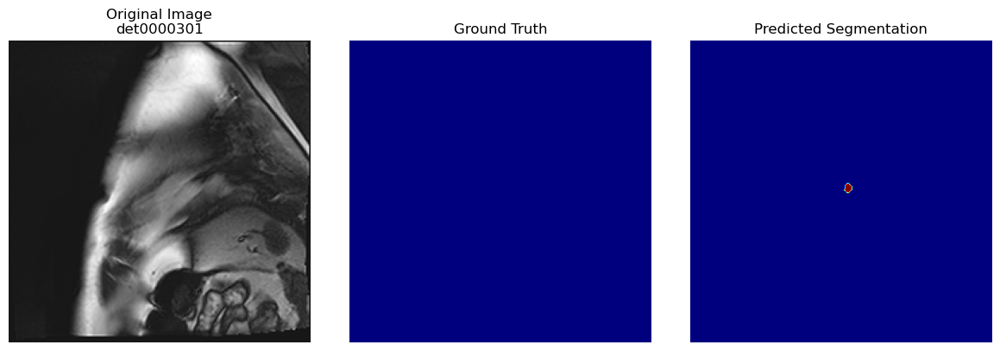

In [132]:
with torch.no_grad():
    for sample in test_loader:
        image = sample["image"].to(device)  # Ảnh gốc
        label = sample["label"].to(device)  # Ground Truth
        case_name = sample["case_name"][0]

        print("Original Image Shape:", image.shape, "Type:", image.dtype)

        # Chuyển đổi ảnh về đúng định dạng
        image = image.permute(0, 3, 1, 2).float()  # Chuyển HWC -> CHW và đổi sang float32

        # Nếu ảnh có 16 kênh nhưng model chỉ nhận 3 kênh, ta chỉ lấy 3 kênh đầu
        if image.shape[1] > 3:
            image = image[:, :3, :, :]

        print("Processed Image Shape:", image.shape, "Type:", image.dtype)

        output = model(image)  # Dự đoán
        pred = torch.argmax(output, dim=1).squeeze(0).cpu().numpy()  # Chuyển sang numpy

        print("Output:", output)
        print("Pred:", pred)

        visualize_prediction(image, label, pred, case_name)


In [117]:
import cv2

def overlay_segmentation(image, segmentation, alpha=0.5):
    """
    Overlay segmentation lên ảnh gốc với hiệu ứng trong suốt.
    """
    img = image[0, 0].cpu().numpy()  # Lấy ảnh gốc
    seg = segmentation.astype(np.uint8)  # Convert về uint8

    # Chuẩn hóa ảnh về 0-255
    img = ((img - img.min()) / (img.max() - img.min()) * 255).astype(np.uint8)

    # Chuyển nhãn thành ảnh màu
    seg_color = cv2.applyColorMap(seg * 30, cv2.COLORMAP_JET)  # Mỗi nhãn có màu riêng

    # Chuyển ảnh grayscale sang RGB
    img_color = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)

    # Overlay bằng alpha blending
    blended = cv2.addWeighted(img_color, 1 - alpha, seg_color, alpha, 0)

    plt.figure(figsize=(6, 6))
    plt.imshow(blended)
    plt.title("Overlay Segmentation")
    plt.axis("off")
    plt.show()

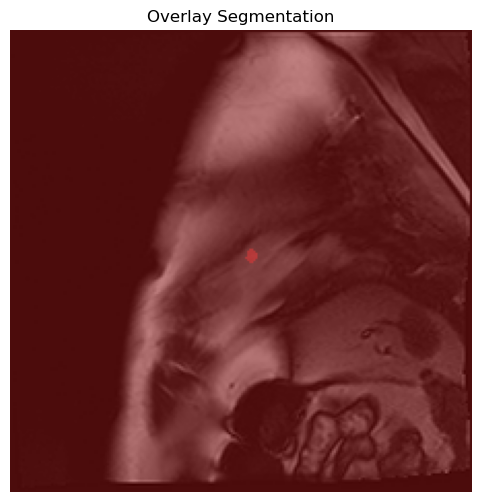

In [118]:
# Gọi hàm overlay
overlay_segmentation(image, pred)

In [125]:
def visualize_3d_slices(image, label, prediction, slice_idx_image=None, slice_idx_label=None, slice_idx_pred=None):
    """
    Hiển thị một vài lát cắt của ảnh 3D để kiểm tra segmentation.
    """
    if slice_idx_image is None:
        slice_idx_image = image.shape[2] // 2  # Chọn lát cắt giữa của ảnh
    if slice_idx_label is None:
        slice_idx_label = label.shape[2] // 2  # Chọn lát cắt giữa của nhãn

    # Check if prediction is 3D
    if prediction.ndim == 3:
        if slice_idx_pred is None:
            slice_idx_pred = prediction.shape[2] // 2  # Chọn lát cắt giữa của dự đoán
        pred_slice = prediction[:, :, slice_idx_pred]
    else:
        # Prediction is assumed to be 2D already
        pred_slice = prediction

    plt.figure(figsize=(12, 4))

    # Ảnh gốc
    plt.subplot(1, 3, 1)
    plt.imshow(image[:, :, slice_idx_image], cmap="gray")
    plt.title("Original Image")
    plt.axis("off")

    # Ground Truth
    plt.subplot(1, 3, 2)
    plt.imshow(label[:, :, slice_idx_label], cmap="jet")
    plt.title("Ground Truth")
    plt.axis("off")

    # Prediction
    plt.subplot(1, 3, 3)
    plt.imshow(pred_slice, cmap="jet")
    plt.title("Predicted Segmentation")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


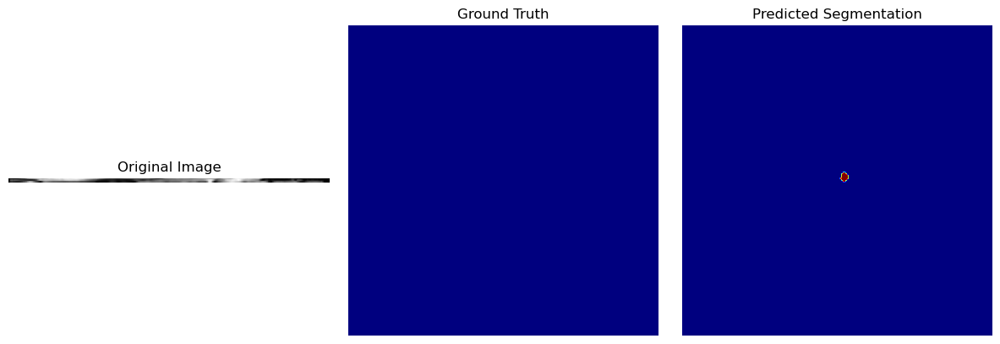

In [126]:
# Chạy visualization cho ảnh 3D (nếu có)
if image.ndim == 4:  # Nếu là ảnh 3D
    visualize_3d_slices(image.squeeze(0).cpu().numpy(), label.squeeze(0).cpu().numpy(), pred)

In [1]:
import os
import nibabel as nib
import numpy as np
import matplotlib.pyplot as plt

In [2]:
def load_nii(file_path):
    nii = nib.load(file_path)
    return nii.get_fdata()

In [3]:
def visualize_all_slices_in_groups(image, ground_truth, prediction, n_cols=10):
    """
    Hiển thị tất cả các lát cắt theo nhóm với n_cols mỗi figure.
    Mỗi figure có 3 hàng (Input, Ground Truth, Prediction) và n_cols cột.
    """
    total_slices = image.shape[2]
    n_groups = int(np.ceil(total_slices / n_cols))

    for group in range(n_groups):
        start = group * n_cols
        end = min((group + 1) * n_cols, total_slices)
        current_slices = range(start, end)

        # Số cột theo số lát cắt trong nhóm hiện tại
        cols = len(current_slices)
        fig, axes = plt.subplots(3, cols, figsize=(cols * 3, 9))

        # Nếu chỉ có 1 cột, đảm bảo axes là mảng 2 chiều
        if cols == 1:
            axes = np.expand_dims(axes, axis=1)

        for i, slice_idx in enumerate(current_slices):
            # Hàng 0: Ảnh gốc
            axes[0, i].imshow(image[:, :, slice_idx], cmap="gray")
            axes[0, i].set_title(f"Slice {slice_idx}")
            axes[0, i].axis("off")

            # Hàng 1: Ảnh gốc + Ground Truth
            axes[1, i].imshow(image[:, :, slice_idx], cmap="gray")
            axes[1, i].imshow(ground_truth[:, :, slice_idx], cmap="jet", alpha=0.6)
            axes[1, i].axis("off")

            # Hàng 2: Ảnh gốc + Prediction
            axes[2, i].imshow(image[:, :, slice_idx], cmap="gray")
            axes[2, i].imshow(prediction[:, :, slice_idx], cmap="jet", alpha=0.6)
            axes[2, i].axis("off")

        # Đặt nhãn cho các hàng ở cột đầu tiên
        axes[0, 0].set_ylabel("Input", fontsize=14)
        axes[1, 0].set_ylabel("Ground Truth", fontsize=14)
        axes[2, 0].set_ylabel("Prediction", fontsize=14)

        plt.tight_layout()
        plt.show()

img shape: (512, 512, 139)
gt shape: (512, 512, 139)
pred shape: (512, 512, 139)


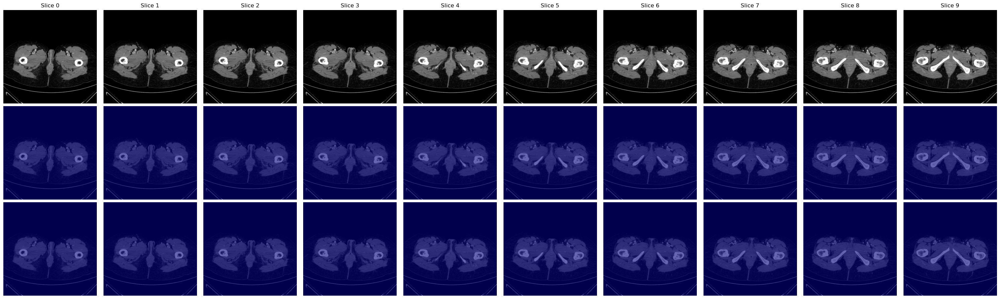

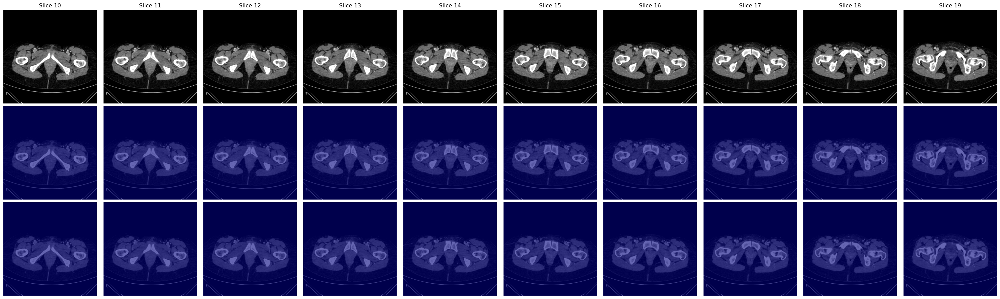

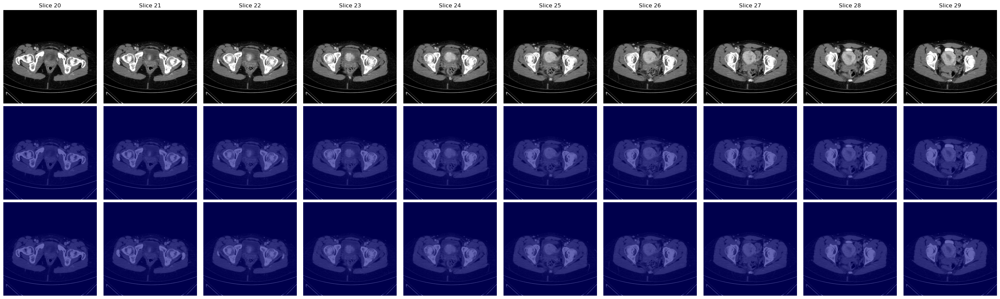

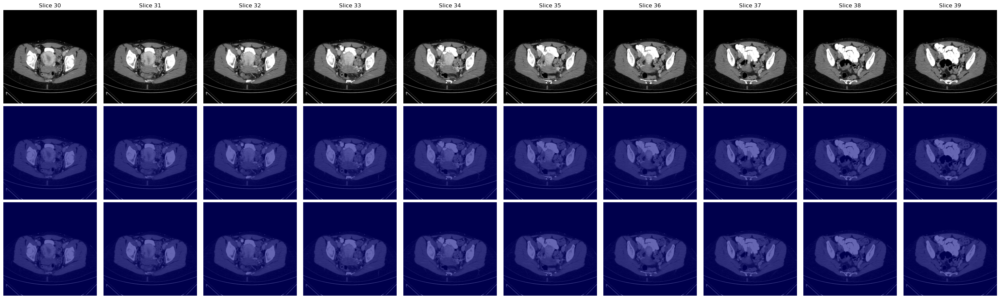

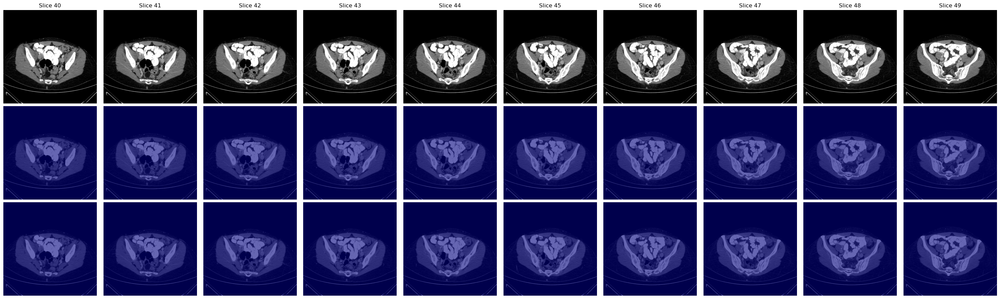

...

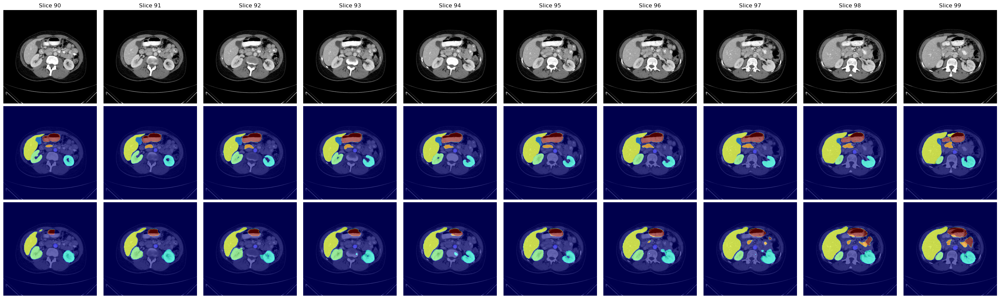

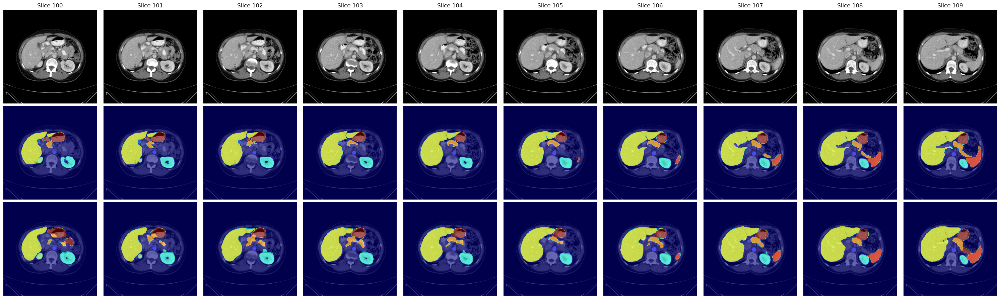

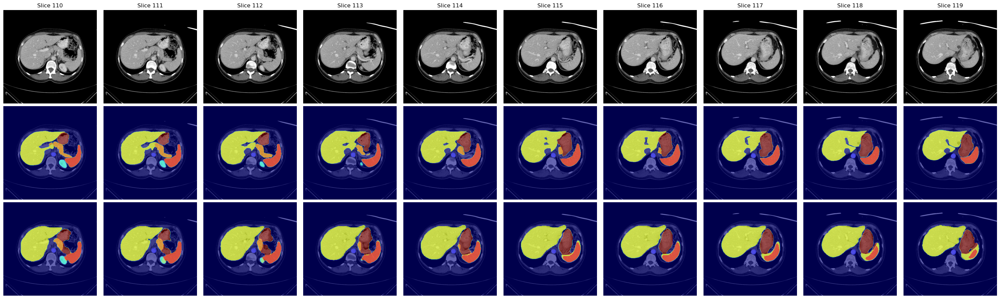

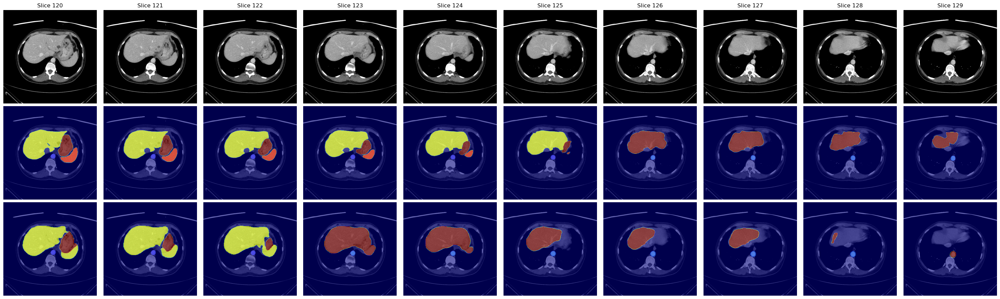

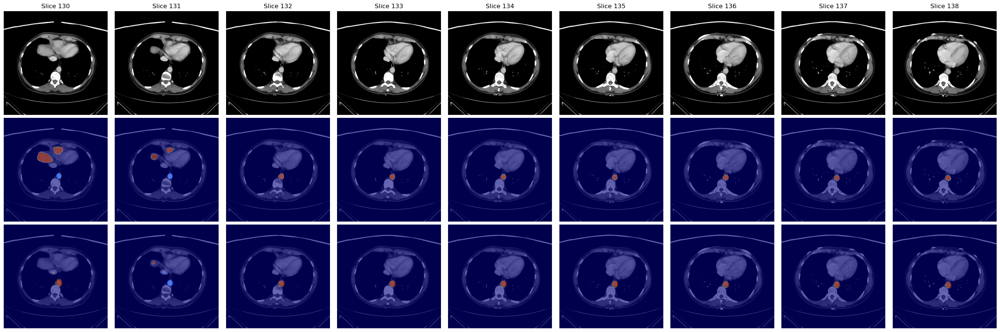

In [5]:
# Load dữ liệu
base_dir = "predictions/TU_synapse224/TU_pretrain_R50-ViT-B_16_skip2_epo5_bs2_224"
case_id = "case0002"  # Thay bằng ID case cần xem
img_path = os.path.join(base_dir, f"{case_id}_img.nii.gz")
gt_path = os.path.join(base_dir, f"{case_id}_gt.nii.gz")
pred_path = os.path.join(base_dir, f"{case_id}_pred.nii.gz")

img = load_nii(img_path)
gt = load_nii(gt_path)
pred = load_nii(pred_path)

print("img shape:", img.shape)
print("gt shape:", gt.shape)
print("pred shape:", pred.shape)

visualize_all_slices_in_groups(img, gt, pred, n_cols=10)